# Analysis of Davidson County Property Assessments

In [1]:
'''
The collection of Real Property Taxes in Davidson County is the responsibility of the Office of the Trustee.

The Property Assessor places the appraised value on residential and commercial properties. The Trustee accepts the
Certified Real Property Tax Roll from the Property Assessor in September each year for collection.

Property tax statements are generated from the Tax Roll and mailed the first week of October each year.
'''
print()

In [2]:
from shapely.geometry import Point
from datetime import datetime
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
import numpy as np

In [3]:
NAL = pd.read_csv('../data/file.csv')
NAL.head(10)

C:\Users\Scott\anaconda3\envs\geospatial\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (13,18) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,...,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
0,1,001 00 0 001.00,00100000100,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE RAY & HELEN F.",12/05/2006,DC-20110805 0060547,7500.0,...,1733,0,na,13169,3292,0,3292,0.25,NaN,0.25
1,2,001 00 0 002.00,00100000200,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE R.",05/17/1983,DB-00006058 0000985,12500.0,...,2274,0,na,20239,5060,0,5060,0.25,NaN,0.25
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",03/27/1989,DB-00007802 0000048,270000.0,...,18023,0,na,31000,0,0,0,0.00,NaN,0.00
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,small parcel,0,na,15400,0,0,0,0.00,NaN,0.00
5,5,002 00 0 001.00 002,00200000100002,NaN,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,16493,0,na,34800,0,0,0,0.00,NaN,0.00
6,6,002 00 0 002.00,00200000200,10.0,37010202.0,RIDGETOP (GSD),"MUELLER, EDWARD DUANE, JR.",09/05/2014,DB-20140909 0082428,50000.0,...,small parcel,33000,na,63000,7500,8250,15750,0.25,0.25,0.25
7,7,002 00 0 003.00,00200000300,10.0,37010202.0,RIDGETOP (GSD),"SHRUM FAMILY HOLDINGS, INC.",12/22/2010,DC-20120106 0001670,95000.0,...,18006,142400,74,198400,14000,35600,49600,0.25,0.25,0.25
8,8,002 00 0 007.00,00200000700,10.0,37010202.0,RIDGETOP (GSD),"SUMMERS, SALLY C.",11/24/2004,DB-20041201 0142810,115000.0,...,19455,180400,123,230400,12500,45100,57600,0.25,0.25,0.25
9,9,002 00 0 008.00,00200000800,10.0,37010202.0,RIDGETOP (GSD),"ROGERS, KATHRYN",02/03/2016,AF-20170210 0014262,NaN,...,21453,0,na,25100,6275,0,6275,0.25,NaN,0.25


In [4]:
# increase number of columns/rows pandas displays
pd.set_option("display.max_columns", 50)
pd.set_option("display.max_rows", None)
pd.set_option("display.max_colwidth", 60)
NAL.head()

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
0,1,001 00 0 001.00,00100000100,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE RAY & HELEN F.",12/05/2006,DC-20110805 0060547,7500.0,204 SAVANNAH EAST CT,SPRINGFIELD,TN,37172,US,0 WHITES CREEK PIKE,WHITES CREEK PIKE,0,NaN,JOELTON,TN,37080,36.389204,-86.900090,W SIDE WHITES CREEK PIKE N OF COOPERTOWN RD,DB-00000137 0000216,01/01/2008,7.60,0,0,0,GREENBELT/RES\r\nGRRENBELT/RES,A,AGR 25%,13169,1733,0,na,13169,3292,0,3292,0.25,NaN,0.25
1,2,001 00 0 002.00,00100000200,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE R.",05/17/1983,DB-00006058 0000985,12500.0,204 SAVANNAH EAST CT,SPRINGFIELD,TN,37172,US,8538 WHITES CREEK PIKE,WHITES CREEK PIKE,8538,NaN,JOELTON,TN,37080,36.389417,-86.898070,E SIDE WHITES CREEK PIKE N OF COOPERTOWN RD.,DB-00000155 0000282,01/06/1972,8.90,0,0,0,GREENBELT/RES\r\nGRRENBELT/RES,A,AGR 25%,20239,2274,0,na,20239,5060,0,5060,0.25,NaN,0.25
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",03/27/1989,DB-00007802 0000048,270000.0,8661 WHITES CREEK PIKE,JOELTON,TN,37080,US,8663 WHITES CREEK PIKE,WHITES CREEK PIKE,8663,NaN,JOELTON,TN,37080,36.389238,-86.904732,ASSESSED IN ROBERTSON COUNTY,DB-00007326 0000026,08/14/1987,1.72,0,0,0,VACANT RURAL LAND,L,ASS 0%,31000,18023,0,na,31000,0,0,0,0.00,NaN,0.00
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1005 HIGHLAND AVE,HIGHLAND AVE,1005,NaN,GOODLETTSVILLE,TN,37072,36.391198,-86.776650,S/S HIGHLAND AV W OLD BUCK HILL RD(SPECIAL INT RIDGETOP/...,DB-00005215 0000894,09/19/1986,2.90,0,0,0,SINGLE FAMILY,E,EXE 0%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 B HIGHLAND AVE,HIGHLAND AVE,1003 B,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT RIDGE...,DB-00005215 0000894,09/19/1986,0.79,0,0,0,VACANT RURAL LAND,E,EXE 0%,15400,small parcel,0,na,15400,0,0,0,0.00,NaN,0.00


In [5]:
NAL.dtypes

AccountNumber                 int64
ParcelID                     object
UserAccount                  object
CouncilDistrict             float64
CensusBlock                 float64
TaxDistrict                  object
OwnerName                    object
Owner_DateAcquired           object
OwnerInstrument              object
OwnerSalePrice              float64
OwnerAddress                 object
OwnerCity                    object
OwnerStateCode               object
OwnerPostalCode              object
OwnerCountryCode             object
AddressFullAddress           object
AddressFullStreet            object
AddressFullNum               object
AddressSuite                 object
AddressCity                  object
AddressStateCode             object
AddressPostalCode             int64
Latitude                    float64
Longitude                   float64
PropertyLegalDescription     object
PropertyDocument             object
Property_DocumentDate        object
Acres                       

In [6]:
# Convert Owner_DateAcquired to datetime
NAL.Owner_DateAcquired = pd.to_datetime(NAL.Owner_DateAcquired,  errors='coerce')

In [7]:
# <M8[ns] is a datetime data type, similar to datetime64.
NAL.Owner_DateAcquired.dtypes

dtype('<M8[ns]')

In [8]:
NAL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 268476 entries, 0 to 268475
Data columns (total 45 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   AccountNumber             268476 non-null  int64         
 1   ParcelID                  268476 non-null  object        
 2   UserAccount               268476 non-null  object        
 3   CouncilDistrict           268377 non-null  float64       
 4   CensusBlock               268434 non-null  float64       
 5   TaxDistrict               267428 non-null  object        
 6   OwnerName                 268476 non-null  object        
 7   Owner_DateAcquired        268475 non-null  datetime64[ns]
 8   OwnerInstrument           268476 non-null  object        
 9   OwnerSalePrice            217656 non-null  float64       
 10  OwnerAddress              267541 non-null  object        
 11  OwnerCity                 267541 non-null  object        
 12  Ow

## Analyze nulls for anomalies/discrepancies

In [9]:
# identify columns having null values
null_columns = NAL.columns[NAL.isnull().any()]
null_columns

Index(['CouncilDistrict', 'CensusBlock', 'TaxDistrict', 'Owner_DateAcquired',
       'OwnerSalePrice', 'OwnerAddress', 'OwnerCity', 'OwnerStateCode',
       'OwnerPostalCode', 'OwnerCountryCode', 'AddressFullStreet',
       'AddressSuite', 'Latitude', 'Longitude', 'LandUse', 'ClassCodes',
       'ClassDescription', 'LandAssess%', 'ImproveAssess%', 'TotalAssess%'],
      dtype='object')

In [10]:
# get a count of null values
NAL[null_columns].isna().sum()

CouncilDistrict           99
CensusBlock               42
TaxDistrict             1048
Owner_DateAcquired         1
OwnerSalePrice         50820
OwnerAddress             935
OwnerCity                935
OwnerStateCode           311
OwnerPostalCode          935
OwnerCountryCode         313
AddressFullStreet         55
AddressSuite          246914
Latitude                5589
Longitude               5589
LandUse                 1350
ClassCodes              5196
ClassDescription        5196
LandAssess%             5337
ImproveAssess%         34776
TotalAssess%            5287
dtype: int64

### Investigate data for zip codes having low counts for residential parcels, which seems highly irregular.

In [11]:
# locate 'AddressPostalCode' of records where ClassCodes = 'R' (residential)
NAL.loc[NAL.ClassCodes == 'R', 'AddressPostalCode']

6         37072
7         37072
8         37072
9         37072
10        37072
11        37072
12        37072
13        37072
17        37072
18        37072
19        37072
20        37072
21        37072
22        37072
23        37072
24        37072
25        37072
26        37072
27        37072
28        37072
29        37072
30        37072
31        37072
34        37072
35        37072
39        37072
40        37072
41        37072
42        37072
43        37072
44        37072
45        37072
46        37072
47        37072
48        37072
49        37072
50        37072
52        37072
53        37072
54        37072
55        37072
58        37072
59        37072
60        37072
61        37072
70        37072
81        37072
82        37072
83        37072
84        37072
89        37072
90        37072
92        37072
93        37072
94        37072
95        37072
96        37072
97        37072
108       37072
109       37072
110       37072
111       37072
112     

In [12]:
# count values
NAL.loc[NAL.ClassCodes == 'R', 'AddressPostalCode'].value_counts()

37013    25546
37211    19600
37221    14220
37207    12598
37209    12398
37076    11863
37214    11232
37115    10727
37215     9789
37205     9747
37206     9108
37216     7791
37217     7053
37138     6274
37208     5937
37218     5721
37072     5408
37027     5336
37204     4697
37212     4503
37203     4289
37210     3924
37220     2777
37080     2078
37189     1651
37135     1432
37219      688
37201      591
37122      288
37143      244
37015      219
37064       40
37086        3
36215        1
37127        1
Name: AddressPostalCode, dtype: int64

#### I investigated the zips with low count of residential properties and found the following:
- zip 36215 (1 parcel) is an error.  Should be 37215.
- Other zips with low counts (37217, 37086, 37064, 37015, 37143, 37122) are at edge of county divided by county lines in mostly rural areas, with generally small portions lying within Davidson County.

In [13]:
zipcodes = gpd.read_file('../data/zipcodes.geojson') 
print(zipcodes.crs)
zipcodes.head( )

epsg:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 36.31821, ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 36.23771, ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 36.13360, ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 36.06308, ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 36.01180, ..."


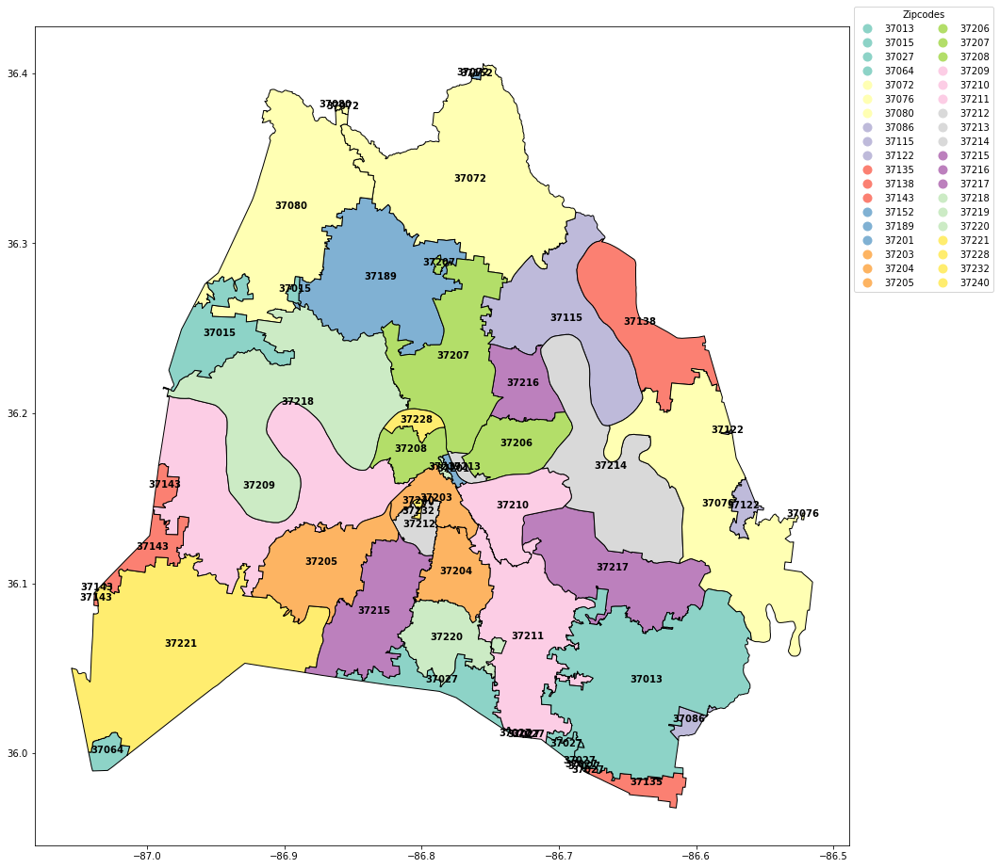

In [14]:
leg_kwds = {'title': 'Zipcodes', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}

zipcodes.plot(column = 'zip', cmap = 'Set3',figsize = (16,16),edgecolor = 'black',
              legend = True, legend_kwds = leg_kwds)

for index, row in zipcodes.iterrows():
    plt.annotate(text=row['zip'], 
                 xy=(row['geometry'].centroid.x, row['geometry'].centroid.y),
                 horizontalalignment='center', fontweight = 'bold');

## Analyze parcels by ClassDescription

In [15]:
NAL_classdescriptions = NAL.ClassDescription.value_counts(dropna=False).reset_index()
NAL_classdescriptions

,index,ClassDescription
0,RES 25%,217774
1,COM 40%,25732
2,COM 0%,9455
3,EXE 0%,5646
4,NaN,5196
5,IND 40%,1149
6,AGR 25%,1066
7,FOR 25%,786
8,FAR 25%,534
9,COM 40% RES 25%,373


In [16]:
NAL_classdescriptions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27 entries, 0 to 26
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   index             26 non-null     object
 1   ClassDescription  27 non-null     int64 
dtypes: int64(1), object(1)
memory usage: 560.0+ bytes


In [17]:
# use .iloc to subset dataframe on row indices having a single class description
NAL_single_CD = NAL_classdescriptions.iloc[[0,1,2,3,4,5,6,7,8,10,12,19]]
NAL_single_CD

,index,ClassDescription
0,RES 25%,217774
1,COM 40%,25732
2,COM 0%,9455
3,EXE 0%,5646
4,NaN,5196
5,IND 40%,1149
6,AGR 25%,1066
7,FOR 25%,786
8,FAR 25%,534
10,ASS 0%,266


In [18]:
# DO NOT RUN AGAIN. Already been exported
# NAL_single_CD.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\NAL_single_CD.value_counts.xlsx', index = False, header=True)

## Analyze parcels having tax assessment = 0

In [19]:
# What parcels have tax assessment = 0
assessment_0 = NAL.loc[NAL.TotalAssessment == 0] 
assessment_0.head()

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",1989-03-27,DB-00007802 0000048,270000.0,8661 WHITES CREEK PIKE,JOELTON,TN,37080,US,8663 WHITES CREEK PIKE,WHITES CREEK PIKE,8663,NaN,JOELTON,TN,37080,36.389238,-86.904732,ASSESSED IN ROBERTSON COUNTY,DB-00007326 0000026,08/14/1987,1.72,0,0,0,VACANT RURAL LAND,L,ASS 0%,31000,18023,0,na,31000,0,0,0,0.0,NaN,0.0
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1005 HIGHLAND AVE,HIGHLAND AVE,1005,NaN,GOODLETTSVILLE,TN,37072,36.391198,-86.776650,S/S HIGHLAND AV W OLD BUCK HILL RD(SPECIAL INT RIDGETOP/...,DB-00005215 0000894,09/19/1986,2.90,0,0,0,SINGLE FAMILY,E,EXE 0%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 B HIGHLAND AVE,HIGHLAND AVE,1003 B,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT RIDGE...,DB-00005215 0000894,09/19/1986,0.79,0,0,0,VACANT RURAL LAND,E,EXE 0%,15400,small parcel,0,na,15400,0,0,0,0.0,NaN,0.0
5,5,002 00 0 001.00 002,00200000100002,NaN,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 C HIGHLAND AVE,HIGHLAND AVE,1003 C,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT G.S.D.),DB-00005215 0000894,09/19/1986,2.11,0,0,0,VACANT RURAL LAND,E,EXE 0%,34800,16493,0,na,34800,0,0,0,0.0,NaN,0.0
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN


In [20]:
# how many parcels have tax assessment = 0
len(assessment_0) # or assessment_0.shape

20772

In [21]:
assessment_0_a = assessment_0[['UserAccount','LandUse','ClassCodes','ClassDescription']]
assessment_0_a

,UserAccount,LandUse,ClassCodes,ClassDescription
2,00100000300,VACANT RURAL LAND,L,ASS 0%
3,00200000100,SINGLE FAMILY,E,EXE 0%
4,00200000100001,VACANT RURAL LAND,E,EXE 0%
5,00200000100002,VACANT RURAL LAND,E,EXE 0%
10,00200001001,SINGLE FAMILY,R,RES 25%
14,00200001200,SINGLE FAMILY,F,FAR 25%
21,00200001700,VACANT RURAL LAND,R,RES 25%
24,00200001800,MOBILE HOME,R,RES 25%
27,00200001900,VACANT RURAL LAND,R,RES 25%
36,00200002500,VACANT RURAL LAND,F,FAR 25%


In [22]:
# select columns to perform value counts on
assessment_0_b = assessment_0[['LandUse','ClassCodes','ClassDescription']]
assessment_0_b

,LandUse,ClassCodes,ClassDescription
2,VACANT RURAL LAND,L,ASS 0%
3,SINGLE FAMILY,E,EXE 0%
4,VACANT RURAL LAND,E,EXE 0%
5,VACANT RURAL LAND,E,EXE 0%
10,SINGLE FAMILY,R,RES 25%
14,SINGLE FAMILY,F,FAR 25%
21,VACANT RURAL LAND,R,RES 25%
24,MOBILE HOME,R,RES 25%
27,VACANT RURAL LAND,R,RES 25%
36,VACANT RURAL LAND,F,FAR 25%


In [23]:
# use .columns inside for-loop to display value counts including nulls for each column
for col in assessment_0_b.columns:
    print('-' * 40 + col + '-' * 40 , end=' - ')
    display(assessment_0_b[col].value_counts(dropna=False))

----------------------------------------LandUse---------------------------------------- - 

VACANT RESIDENTIAL LAND                                14209
NaN                                                     1323
CHURCH                                                   759
RESIDENTIAL CONDO                                        522
PARKING LOT                                              438
SINGLE FAMILY                                            425
VACANT COMMERCIAL LAND                                   381
VACANT RURAL LAND                                        304
METRO OTHER THAN OFC, SCHOOL,HOSP, OR PARK               295
SCHOOL OR COLLEGE                                        273
MORTUARY/CEMETERY                                        267
DUPLEX                                                   185
PARK OR RECREATION                                       131
OFFICE BLDG (ONE OR TWO STORIES)                         123
VACANT RESIDENTIAL                                       122
VACANT INDUSTRIAL LAND                                    96
APARTMENT: LOW RISE (BUI

----------------------------------------ClassCodes---------------------------------------- - 

O      9455
E      5646
NaN    5196
L       266
B       159
R        23
C        18
F         5
T         3
A         1
Name: ClassCodes, dtype: int64

----------------------------------------ClassDescription---------------------------------------- - 

COM 0%     9455
EXE 0%     5646
NaN        5196
ASS 0%      266
OSA 0%      159
RES 25%      23
COM 40%      18
FAR 25%       5
FOR 25%       3
AGR 25%       1
Name: ClassDescription, dtype: int64

In [24]:
assessment_0_b1 =assessment_0_b.ClassCodes.value_counts(dropna=False).reset_index()
assessment_0_b1

,index,ClassCodes
0,O,9455
1,E,5646
2,NaN,5196
3,L,266
4,B,159
5,R,23
6,C,18
7,F,5
8,T,3
9,A,1


In [25]:
# DO NOT RUN AGAIN. Already been exported
#assessment_0_b1.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\ClassCodes.value_counts.xlsx', index = False, header=True)

In [26]:
assessment_0_b2 = assessment_0_b.ClassDescription.value_counts(dropna=False).reset_index()
assessment_0_b2

,index,ClassDescription
0,COM 0%,9455
1,EXE 0%,5646
2,NaN,5196
3,ASS 0%,266
4,OSA 0%,159
5,RES 25%,23
6,COM 40%,18
7,FAR 25%,5
8,FOR 25%,3
9,AGR 25%,1


In [27]:
# DO NOT RUN AGAIN. Already been exported
# assessment_0_b2.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\ClassDescription.value_counts.xlsx', index = False, header=True)

In [28]:
assessment_0_b3 = assessment_0_b.LandUse.value_counts(dropna=False).reset_index()

In [29]:
# convert strings to title case
assessment_0_b3['index'] = assessment_0_b3['index'].str.title()
assessment_0_b3

,index,LandUse
0,Vacant Residential Land,14209
1,NaN,1323
2,Church,759
3,Residential Condo,522
4,Parking Lot,438
5,Single Family,425
6,Vacant Commercial Land,381
7,Vacant Rural Land,304
8,"Metro Other Than Ofc, School,Hosp, Or Park",295
9,School Or College,273


In [30]:
# DO NOT RUN AGAIN. Already been exported
# assessment_0_b3.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\LandUse.value_counts.xlsx', index = False, header=True)

In [31]:
# there are 3177 vacant residential land parcels having assessment = 0 and ClassCode = null
temp_df = assessment_0_a.loc[(assessment_0_a.LandUse == 'VACANT RESIDENTIAL LAND') & (assessment_0_a.ClassCodes.isnull())]
len(temp_df)

3177

In [32]:
# this coding reveals that all unassessed parcels where LandUse = 'RESIDENTIAL CONDO' are common areas because no records
# were returned for UserAccounts that do NOT contain 'CO' (which designates common areas) appended. Exclude from further analysis
assessment_0_a.loc[(~assessment_0_a.UserAccount.str.contains('CO')) & (assessment_0_a.LandUse == 'RESIDENTIAL CONDO')]

,UserAccount,LandUse,ClassCodes,ClassDescription


In [33]:
# locate UserAccounts NOT containing CO where ClassCode is Null OR where ClassCode includes codes R,C,F,T,A.
# The excluded records are for unassessed Common Areas/Open Areas (CO) typically found in Condominium properties.
temp_df = assessment_0_a.loc[(~assessment_0_a.UserAccount.str.contains('CO') & assessment_0_a.ClassCodes.isnull())
                            | (assessment_0_a.ClassCodes.isin(['R','C','F','T','A']))]
temp_df

,UserAccount,LandUse,ClassCodes,ClassDescription
10,00200001001,SINGLE FAMILY,R,RES 25%
14,00200001200,SINGLE FAMILY,F,FAR 25%
21,00200001700,VACANT RURAL LAND,R,RES 25%
24,00200001800,MOBILE HOME,R,RES 25%
27,00200001900,VACANT RURAL LAND,R,RES 25%
36,00200002500,VACANT RURAL LAND,F,FAR 25%
42,00200003000,SINGLE FAMILY,R,RES 25%
46,00200003200,SINGLE FAMILY,R,RES 25%
55,00200004100,VACANT RURAL LAND,R,RES 25%
82,00200006900,SINGLE FAMILY,R,RES 25%


In [34]:
# My analysis found 313 parcels (that are not Common Areas) with no assessment and no reason for exclusion per ClassCode.
len(temp_df)

313

In [35]:
# locate UserAccounts containing CO where ClassCode is Null
# The included records are for unassessed Common Areas/Open Areas (CO) typically found in Condominium properties.
temp_df1 = assessment_0_a.loc[assessment_0_a.UserAccount.str.contains('CO') & assessment_0_a.ClassCodes.isnull()]
len(temp_df1)

4933

In [36]:
# Get value count of LandUse on the 313 unassessed parcels
temp_df.LandUse.value_counts(dropna=False).reset_index()

,index,LandUse
0,NaN,138
1,VACANT RESIDENTIAL LAND,57
2,VACANT COMMERCIAL LAND,40
3,SINGLE FAMILY,29
4,VACANT RURAL LAND,17
5,VACANT ZONED MULTI FAMILY,5
6,MOBILE HOME,4
7,FOREST,3
8,STRIP SHOPPING CENTER,2
9,RESIDENTIAL COMBO/MISC,2


In [37]:
# send index of temp dataframe to list
temp_index = temp_df.index.to_list()
temp_index

[10,
 14,
 21,
 24,
 27,
 36,
 42,
 46,
 55,
 82,
 92,
 95,
 109,
 385,
 451,
 455,
 480,
 491,
 494,
 582,
 1201,
 2468,
 3359,
 3362,
 3366,
 3828,
 3829,
 4620,
 5305,
 5519,
 5520,
 7207,
 7226,
 8431,
 9096,
 9097,
 9371,
 9850,
 9851,
 9852,
 9853,
 10708,
 11012,
 11015,
 11045,
 11046,
 11516,
 11517,
 16925,
 20573,
 20574,
 20575,
 20576,
 20577,
 22406,
 22565,
 22753,
 22759,
 23211,
 23212,
 23213,
 23845,
 26011,
 26990,
 29102,
 29103,
 29104,
 29105,
 29106,
 29107,
 29108,
 30326,
 32391,
 34524,
 34923,
 43074,
 43075,
 43535,
 43536,
 45200,
 46352,
 46353,
 46354,
 46637,
 46638,
 47205,
 47206,
 47207,
 47208,
 47209,
 47210,
 49043,
 49044,
 49045,
 49046,
 49047,
 49048,
 49049,
 49050,
 49051,
 51137,
 51138,
 51139,
 51140,
 51141,
 51142,
 51143,
 51144,
 51145,
 51146,
 51147,
 53337,
 54995,
 54996,
 54997,
 54998,
 55281,
 55282,
 56038,
 56548,
 56549,
 56550,
 56551,
 56552,
 56884,
 56885,
 57193,
 57917,
 57918,
 59168,
 60199,
 64198,
 64767,
 72063,
 

In [38]:
# use above list of indices to return complete data for each record
unassessed = assessment_0.loc[temp_index]
unassessed

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN
14,14,002 00 0 012.00,00200001200,10.0,37010202.0,GENERAL SERVICES DISTRICT,"NEWELL, MARTHA ANN",2019-04-17,QC-20190422 0036613,NaN,1855 LAKE RD,GREENBRIER,TN,37073,US,1855 LAKE RD,LAKE RD,1855,NaN,GOODLETTSVILLE,TN,37072,36.398920,-86.759283,E/S LAKE RD N OF EAST END RD (SPEC INT RIDGETOP/GSD),DB-00002435 0000357,01/01/1986,41.81,0,0,0,SINGLE FAMILY,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
21,27,002 00 0 017.00,00200001700,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CURTIS, LEWIS W.,JR.& CAGE, TERRI V.C.",1993-10-26,DB-00009190 0000664,6000.0,2731 WALLINGFORD RD,WINSTON SALEM,NC,27101,US,0 EAST END RD,EAST END RD,0,NaN,GOODLETTSVILLE,TN,37072,36.395749,-86.759497,N SIDE EAST END RD E OF HWY 41 (SPECIAL INT RIDGETOP/G.S...,DB-00004062 0000580,09/19/1986,5.05,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
24,30,002 00 0 018.00,00200001800,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,155 EAST END RD,EAST END RD,155,NaN,GOODLETTSVILLE,TN,37072,36.395032,-86.758691,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00004556 0000971,09/19/1986,4.27,0,0,0,MOBILE HOME,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
27,33,002 00 0 019.00,00200001900,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,161 EAST END RD,EAST END RD,161,NaN,GOODLETTSVILLE,TN,37072,36.395661,-86.757953,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,4.23,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
36,42,002 00 0 025.00,00200002500,10.0,37010202.0,GENERAL SERVICES DISTRICT,"LYLE, CHARLENE C.",1981-06-25,QC-00005761 0000809,0.0,2133 HIDDEN VALLEY CIR,LEWISBURG,TN,37091,US,0 SPRINGFIELD HWY,SPRINGFIELD HWY,0,NaN,GOODLETTSVILLE,TN,37072,36.391910,-86.760750,E/S HWY 41 S OF EAST END RD (SPECIAL INT-RIDGETOP/G.S.D.,DB-00008456 0000386,08/21/1991,24.58,0,0,0,VACANT RURAL LAND,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
42,48,002 00 0 030.00,00200003000,10.0,37010202.0,GENERAL SERVICES DISTRICT,"YATES, WILLIAM D. & GERALDINE M.",2002-11-27,DB-20021206 0150442,132500.0,156 E END RD,GOODLETTSVILLE,TN,37072,US,156 EAST END RD,EAST END RD,156,NaN,GOODLETTSVILLE,TN,37072,36.393149,-86.759414,S/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,2.51,0,0,0,SINGLE FAMILY,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
46,52,002 00 0 032.00,00200003200,10.0,37010202.0,GENERAL SERVICES DISTRICT,"PURVIS, BRIAN & RIZZA BADUA",2015-05-11,DB-20150513 0043833,151000.0,168 EAST END RD,GOODLETTSVILLE,TN,37072,US,168 EAST END RD,EAST END RD,168,NaN,GOODLETTSVILLE,TN,37072,36.392875,-86.758626,S/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,1.41,0,0,0,SINGLE FAMILY,

In [39]:
# locate parcels NOT lacking latitude cooordinate
unassessed.loc[~unassessed.Latitude.isna()]

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN
14,14,002 00 0 012.00,00200001200,10.0,37010202.0,GENERAL SERVICES DISTRICT,"NEWELL, MARTHA ANN",2019-04-17,QC-20190422 0036613,NaN,1855 LAKE RD,GREENBRIER,TN,37073,US,1855 LAKE RD,LAKE RD,1855,NaN,GOODLETTSVILLE,TN,37072,36.398920,-86.759283,E/S LAKE RD N OF EAST END RD (SPEC INT RIDGETOP/GSD),DB-00002435 0000357,01/01/1986,41.81,0,0,0,SINGLE FAMILY,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
21,27,002 00 0 017.00,00200001700,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CURTIS, LEWIS W.,JR.& CAGE, TERRI V.C.",1993-10-26,DB-00009190 0000664,6000.0,2731 WALLINGFORD RD,WINSTON SALEM,NC,27101,US,0 EAST END RD,EAST END RD,0,NaN,GOODLETTSVILLE,TN,37072,36.395749,-86.759497,N SIDE EAST END RD E OF HWY 41 (SPECIAL INT RIDGETOP/G.S...,DB-00004062 0000580,09/19/1986,5.05,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
24,30,002 00 0 018.00,00200001800,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,155 EAST END RD,EAST END RD,155,NaN,GOODLETTSVILLE,TN,37072,36.395032,-86.758691,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00004556 0000971,09/19/1986,4.27,0,0,0,MOBILE HOME,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
27,33,002 00 0 019.00,00200001900,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,161 EAST END RD,EAST END RD,161,NaN,GOODLETTSVILLE,TN,37072,36.395661,-86.757953,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,4.23,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
36,42,002 00 0 025.00,00200002500,10.0,37010202.0,GENERAL SERVICES DISTRICT,"LYLE, CHARLENE C.",1981-06-25,QC-00005761 0000809,0.0,2133 HIDDEN VALLEY CIR,LEWISBURG,TN,37091,US,0 SPRINGFIELD HWY,SPRINGFIELD HWY,0,NaN,GOODLETTSVILLE,TN,37072,36.391910,-86.760750,E/S HWY 41 S OF EAST END RD (SPECIAL INT-RIDGETOP/G.S.D.,DB-00008456 0000386,08/21/1991,24.58,0,0,0,VACANT RURAL LAND,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
42,48,002 00 0 030.00,00200003000,10.0,37010202.0,GENERAL SERVICES DISTRICT,"YATES, WILLIAM D. & GERALDINE M.",2002-11-27,DB-20021206 0150442,132500.0,156 E END RD,GOODLETTSVILLE,TN,37072,US,156 EAST END RD,EAST END RD,156,NaN,GOODLETTSVILLE,TN,37072,36.393149,-86.759414,S/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,2.51,0,0,0,SINGLE FAMILY,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
46,52,002 00 0 032.00,00200003200,10.0,37010202.0,GENERAL SERVICES DISTRICT,"PURVIS, BRIAN & RIZZA BADUA",2015-05-11,DB-20150513 0043833,151000.0,168 EAST END RD,GOODLETTSVILLE,TN,37072,US,168 EAST END RD,EAST END RD,168,NaN,GOODLETTSVILLE,TN,37072,36.392875,-86.758626,S/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,1.41,0,0,0,SINGLE FAMILY,

## Create folium map overlayed with zipcode outlines and plot coordinates of parcels

### In order to spatially join parcels coordinates with zipcodes polygon, first create a GeoDataFrame of unassessed parcels
- First create a geometry column that is a Point datatype

In [40]:
"""
It is important to note that in geopandas the geometry column accepts longitude and latitude coordinate pairs, contrary
to the normal order of latitude first, then longitude.
"""
unassessed['geometry'] = unassessed.apply(lambda x: Point((float(x.Longitude), 
                                                         float(x.Latitude))), 
                                        axis=1)
unassessed.head(3)

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%,geometry
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN,POINT (-86.764534 36.393107)
14,14,002 00 0 012.00,00200001200,10.0,37010202.0,GENERAL SERVICES DISTRICT,"NEWELL, MARTHA ANN",2019-04-17,QC-20190422 0036613,NaN,1855 LAKE RD,GREENBRIER,TN,37073,US,1855 LAKE RD,LAKE RD,1855,NaN,GOODLETTSVILLE,TN,37072,36.398920,-86.759283,E/S LAKE RD N OF EAST END RD (SPEC INT RIDGETOP/GSD),DB-00002435 0000357,01/01/1986,41.81,0,0,0,SINGLE FAMILY,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.759283 36.39892)
21,27,002 00 0 017.00,00200001700,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CURTIS, LEWIS W.,JR.& CAGE, TERRI V.C.",1993-10-26,DB-00009190 0000664,6000.0,2731 WALLINGFORD RD,WINSTON SALEM,NC,27101,US,0 EAST END RD,EAST END RD,0,NaN,GOODLETTSVILLE,TN,37072,36.395749,-86.759497,N SIDE EAST END RD E OF HWY 41 (SPECIAL INT RIDGETOP/G.S...,DB-00004062 0000580,09/19/1986,5.05,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.759497 36.395749)


#### The `GeoDataFrame()` constructor needs 3 parameters:
 - a DataFrame
 - a coordinate reference system
 - a geometry

In [41]:
# use crs from zipcodes.geojson file imported earlier
unassessed_geo = gpd.GeoDataFrame(unassessed, 
                           crs = zipcodes.crs, 
                           geometry = unassessed['geometry'])

In [42]:
type(unassessed_geo)

geopandas.geodataframe.GeoDataFrame

In [43]:
zipcodes = zipcodes[['zip', 'geometry']]

In [44]:
# Use geopandas to spatially join the two geo data frames
unassessed_by_zip = gpd.sjoin(unassessed_geo, zipcodes, op = 'within')
unassessed_by_zip.head()

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%,geometry,index_right,zip
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN,POINT (-86.76453 36.39311),8,37072
21,27,002 00 0 017.00,00200001700,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CURTIS, LEWIS W.,JR.& CAGE, TERRI V.C.",1993-10-26,DB-00009190 0000664,6000.0,2731 WALLINGFORD RD,WINSTON SALEM,NC,27101,US,0 EAST END RD,EAST END RD,0,NaN,GOODLETTSVILLE,TN,37072,36.395749,-86.759497,N SIDE EAST END RD E OF HWY 41 (SPECIAL INT RIDGETOP/G.S...,DB-00004062 0000580,09/19/1986,5.05,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.75950 36.39575),8,37072
24,30,002 00 0 018.00,00200001800,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,155 EAST END RD,EAST END RD,155,NaN,GOODLETTSVILLE,TN,37072,36.395032,-86.758691,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00004556 0000971,09/19/1986,4.27,0,0,0,MOBILE HOME,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.75869 36.39503),8,37072
27,33,002 00 0 019.00,00200001900,10.0,37010202.0,GENERAL SERVICES DISTRICT,"CORNISH, MICHAEL L.",2003-07-28,DC-20150130 0009043,0.0,161 E END RD,GOODLETTSVILLE,TN,37072,US,161 EAST END RD,EAST END RD,161,NaN,GOODLETTSVILLE,TN,37072,36.395661,-86.757953,N/S EAST END RD E OF HWY 41 (SPECIAL INT-RIDGETOP/G.S.D.),DB-00000000 0000000,09/19/1986,4.23,0,0,0,VACANT RURAL LAND,R,RES 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.75795 36.39566),8,37072
36,42,002 00 0 025.00,00200002500,10.0,37010202.0,GENERAL SERVICES DISTRICT,"LYLE, CHARLENE C.",1981-06-25,QC-00005761 0000809,0.0,2133 HIDDEN VALLEY CIR,LEWISBURG,TN,37091,US,0 SPRINGFIELD HWY,SPRINGFIELD HWY,0,NaN,GOODLETTSVILLE,TN,37072,36.391910,-86.760750,E/S HWY 41 S OF EAST END RD (SPECIAL INT-RIDGETOP/G.S.D.,DB-00008456 0000386,08/21/1991,24.58,0,0,0,VACANT RURAL LAND,F,FAR 25%,0,0,0,na,0,0,0,0,NaN,NaN,NaN,POINT (-86.76075 36.39191),8,37072


#### Now plot these two together
- first plot the zipcodes polygon
- next plot the points for unassessed parcels and color them by AddressPostalCode

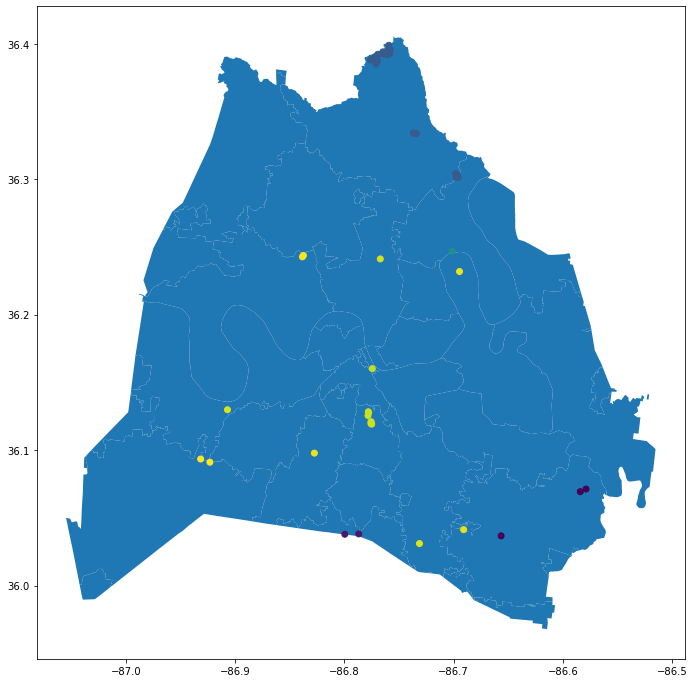

In [45]:
ax = zipcodes.plot(figsize = (12,12))
unassessed_by_zip.plot( ax = ax, column = 'AddressPostalCode');

#### Now plot these onto a folium map.

In [46]:
county_center = [36.166, -86.78]
unassessed_map = folium.Map(location = county_center, zoom_start = 10)

folium.GeoJson(zipcodes).add_to(unassessed_map)

for row_index, row_values in unassessed_by_zip.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['AddressFullAddress'])
    icon=folium.Icon(color="orange",icon="house", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(unassessed_map)

unassessed_map.save('../maps/unassessed_map.html')
unassessed_map

## Analyze unassessed parcels by Date of Acquisition

In [47]:
unassessed_DateAcq = unassessed[['Owner_DateAcquired', 'OwnerName']]
unassessed_DateAcq

,Owner_DateAcquired,OwnerName
10,2018-11-09,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR"
14,2019-04-17,"NEWELL, MARTHA ANN"
21,1993-10-26,"CURTIS, LEWIS W.,JR.& CAGE, TERRI V.C."
24,2003-07-28,"CORNISH, MICHAEL L."
27,2003-07-28,"CORNISH, MICHAEL L."
36,1981-06-25,"LYLE, CHARLENE C."
42,2002-11-27,"YATES, WILLIAM D. & GERALDINE M."
46,2015-05-11,"PURVIS, BRIAN & RIZZA BADUA"
55,2017-05-31,"MORADIPOUR, HOSSEIN & CYNTHIA L."
82,2016-02-03,"ROGERS, KATHRYN"


In [48]:
# use pd.Grouper function to group by year
unassessed_DateAcq_grouped_y = unassessed_DateAcq.groupby(pd.Grouper(key='Owner_DateAcquired', axis=0,freq='Y')).count()
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.reset_index()

In [49]:
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName
0,1979-12-31,1
1,1980-12-31,0
2,1981-12-31,1
3,1982-12-31,0
4,1983-12-31,0
5,1984-12-31,0
6,1985-12-31,1
7,1986-12-31,1
8,1987-12-31,1
9,1988-12-31,1


In [50]:
# exclude years with count = 0
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.loc[unassessed_DateAcq_grouped_y.OwnerName >0]
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName
0,1979-12-31,1
2,1981-12-31,1
6,1985-12-31,1
7,1986-12-31,1
8,1987-12-31,1
9,1988-12-31,1
13,1992-12-31,1
14,1993-12-31,1
16,1995-12-31,1
19,1998-12-31,1


In [51]:
len(unassessed_DateAcq_grouped_y)

29

In [52]:
unassessed_DateAcq_grouped_y.columns

Index(['Owner_DateAcquired', 'OwnerName'], dtype='object')

In [53]:
# add year column using .dt to extract year from 'Owner_DateAcquired'
unassessed_DateAcq_grouped_y['YearAcquired'] = unassessed_DateAcq_grouped_y['Owner_DateAcquired'].dt.year
unassessed_DateAcq_grouped_y

C:\Users\Scott\AppData\Local\Temp/ipykernel_19992/4254009876.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_y['YearAcquired'] = unassessed_DateAcq_grouped_y['Owner_DateAcquired'].dt.year


,Owner_DateAcquired,OwnerName,YearAcquired
0,1979-12-31,1,1979
2,1981-12-31,1,1981
6,1985-12-31,1,1985
7,1986-12-31,1,1986
8,1987-12-31,1,1987
9,1988-12-31,1,1988
13,1992-12-31,1,1992
14,1993-12-31,1,1993
16,1995-12-31,1,1995
19,1998-12-31,1,1998


In [54]:
# Exclude 2021 and chart separately later by each month.  High value with skew bar chart.
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.loc[unassessed_DateAcq_grouped_y.YearAcquired != 2021]
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName,YearAcquired
0,1979-12-31,1,1979
2,1981-12-31,1,1981
6,1985-12-31,1,1985
7,1986-12-31,1,1986
8,1987-12-31,1,1987
9,1988-12-31,1,1988
13,1992-12-31,1,1992
14,1993-12-31,1,1993
16,1995-12-31,1,1995
19,1998-12-31,1,1998


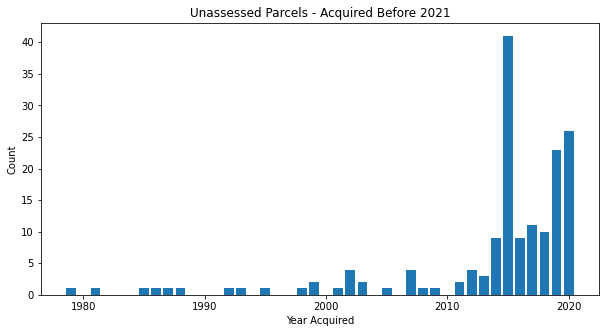

In [55]:
fig, ax = plt.subplots(figsize = (10,5))
plt.bar(unassessed_DateAcq_grouped_y.YearAcquired, unassessed_DateAcq_grouped_y.OwnerName)
plt.xlabel('Year Acquired')
plt.ylabel('Count')
plt.title('Unassessed Parcels - Acquired Before 2021');

In [56]:
# DO NOT RUN AGAIN. Already been exported
# unassessed_DateAcq_grouped_y.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\unassessed_DateAcq_grouped_y.xlsx', index = False, header=True)

### Repeat above analysis for parcels acquired in 2021 grouped by month

In [57]:
# use pd.Grouper function to group by month
unassessed_DateAcq_grouped_m = unassessed_DateAcq.groupby(pd.Grouper(key='Owner_DateAcquired', axis=0,freq='M')).count()
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.reset_index()

In [58]:
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName
0,1979-08-31,1
1,1979-09-30,0
2,1979-10-31,0
3,1979-11-30,0
4,1979-12-31,0
5,1980-01-31,0
6,1980-02-29,0
7,1980-03-31,0
8,1980-04-30,0
9,1980-05-31,0


In [59]:
# exclude months with count = 0
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.loc[unassessed_DateAcq_grouped_m.OwnerName >0]
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName
0,1979-08-31,1
22,1981-06-30,1
76,1985-12-31,1
78,1986-02-28,1
95,1987-07-31,1
103,1988-03-31,1
159,1992-11-30,1
170,1993-10-31,1
185,1995-01-31,1
221,1998-01-31,1


In [60]:
# add year column using .dt to extract year from 'Owner_DateAcquired'
unassessed_DateAcq_grouped_m['YearAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.year

C:\Users\Scott\AppData\Local\Temp/ipykernel_19992/1658305862.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['YearAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.year


In [61]:
# add month column using .dt to extract month name from 'Owner_DateAcquired'
unassessed_DateAcq_grouped_m['MonthAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month_name()

C:\Users\Scott\AppData\Local\Temp/ipykernel_19992/1624508561.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['MonthAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month_name()


In [62]:
# add month order column using .dt to extract month number from 'Owner_DateAcquired'
unassessed_DateAcq_grouped_m['MonthAcquiredOrder'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month

C:\Users\Scott\AppData\Local\Temp/ipykernel_19992/152106175.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['MonthAcquiredOrder'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month


In [63]:
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName,YearAcquired,MonthAcquired,MonthAcquiredOrder
0,1979-08-31,1,1979,August,8
22,1981-06-30,1,1981,June,6
76,1985-12-31,1,1985,December,12
78,1986-02-28,1,1986,February,2
95,1987-07-31,1,1987,July,7
103,1988-03-31,1,1988,March,3
159,1992-11-30,1,1992,November,11
170,1993-10-31,1,1993,October,10
185,1995-01-31,1,1995,January,1
221,1998-01-31,1,1998,January,1


In [64]:
# locate records for year 2021 only
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.loc[unassessed_DateAcq_grouped_m.Owner_DateAcquired.dt.year == 2021]
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName,YearAcquired,MonthAcquired,MonthAcquiredOrder
497,2021-01-31,13,2021,January,1
498,2021-02-28,7,2021,February,2
499,2021-03-31,17,2021,March,3
500,2021-04-30,15,2021,April,4
501,2021-05-31,25,2021,May,5
502,2021-06-30,12,2021,June,6
503,2021-07-31,18,2021,July,7
504,2021-08-31,16,2021,August,8
505,2021-09-30,16,2021,September,9
506,2021-10-31,8,2021,October,10


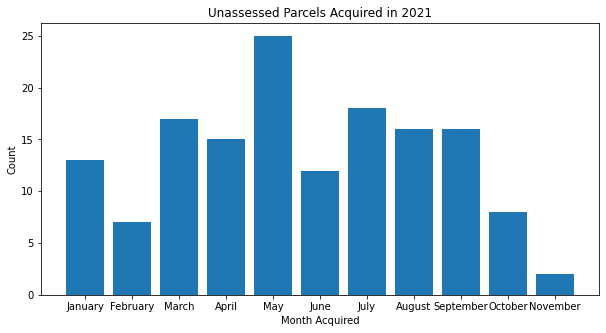

In [65]:
fig, ax = plt.subplots(figsize = (10,5))
plt.bar(unassessed_DateAcq_grouped_m.MonthAcquired, unassessed_DateAcq_grouped_m.OwnerName)
plt.xlabel('Month Acquired')
plt.ylabel('Count')
plt.title('Unassessed Parcels Acquired in 2021');

In [66]:
# DO NOT RUN AGAIN. Already been exported
# unassessed_DateAcq_grouped_m.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\unassessed_DateAcq_grouped_m.xlsx', index = False, header=True)